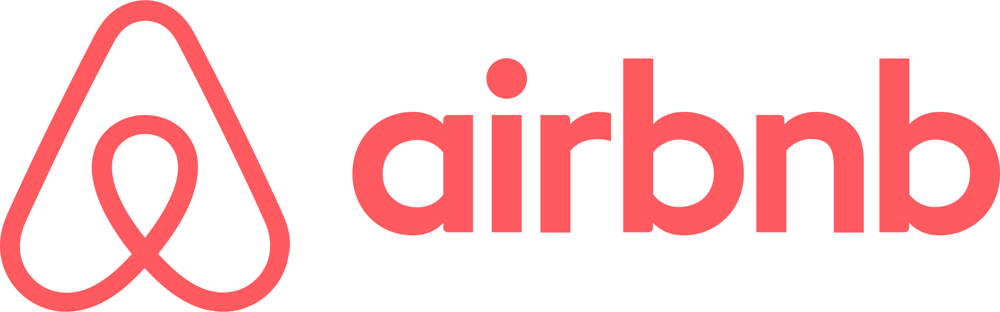

<div>
    <h2>About Dataset :</h2>
<div style="background-color:#FF6B6C;color:#FFFFFB;padding:10px;border:2px solid #2E294E;font-size:1.2em;border-radius:10px">Airbnb, Inc is an American company that operates an online marketplace for lodging, primarily homestays for vacation rentals, and tourism activities. Based in San Francisco, California, the platform is accessible via website and mobile app. Airbnb does not own any of the listed properties; instead, it profits by receiving commission from each booking. The company was founded in 2008. Airbnb is a shortened version of its original name, AirBedandBreakfast.com.
**Context :**
Since 2008, guests and hosts have used Airbnb to travel in a more unique, personalized way. As part of the Airbnb Inside initiative, this dataset describes the listing activity of homestays in New York City</div>
</div>
<h2>Content :</h2>
<div style="background-color:#FF6B6C;color:#FFFFFB;padding:10px;border:2px solid #2E294E;font-size:1.2em;border-radius:10px">
The following Airbnb activity is included in this New York dataset:
Listings, including full descriptions and average review score Reviews, including unique id for each reviewer and detailed comments Calendar, including listing id and the price and availability for that day
</div>
<h2> Table of contents : </h2>
<div style="background-color:#FF6B6C;color:#FFFFFB;padding:10px;border:2px solid #2E294E;font-size:1.2em;border-radius:10px">
1.Data exploring<br>
2.Data cleaning<br>
3.Data visualization<br>
</div>

In [1]:
#Importing libraries :
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
import missingno as msno
#Styling : 
# styling
%matplotlib inline
sns.set_theme(style="dark")
mpl.rcParams['axes.unicode_minus'] = False
pd.set_option('display.max_columns',None)
plt.style.use('seaborn-dark-palette')
plt.style.use('dark_background')

/opt/conda/lib/python3.7/site-packages/geopandas/_compat.py:115: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


<div style="background-color:#FF6B6C;color:#FFFFFB;padding:10px;border:2px solid #2E294E;font-size:1.2em;border-radius:10px">
    <h2 style="text-align:center">1.Exploring the data</h2>
</div>

In [2]:
#Getting data :
df = pd.read_csv("../input/airbnbopendata/Airbnb_Open_Data.csv", low_memory=False)

In [3]:
df.head()

,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,country code,instant_bookable,cancellation_policy,room type,Construction year,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules,license
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.64749,-73.97237,United States,US,False,strict,Private room,2020.0,$966,$193,10.0,9.0,10/19/2021,0.21,4.0,6.0,286.0,Clean up and treat the home the way you'd like...,NaN
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75362,-73.98377,United States,US,False,moderate,Entire home/apt,2007.0,$142,$28,30.0,45.0,5/21/2022,0.38,4.0,2.0,228.0,Pet friendly but please confirm with me if the...,NaN
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.80902,-73.94190,United States,US,True,flexible,Private room,2005.0,$620,$124,3.0,0.0,NaN,NaN,5.0,1.0,352.0,"I encourage you to use my kitchen, cooking and...",NaN
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.68514,-73.95976,United States,US,True,moderate,Entire home/apt,2005.0,$368,$74,30.0,270.0,7/5/2019,4.64,4.0,1.0,322.0,NaN,NaN
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.79851,-73.94399,United States,US,False,moderate,Entire home/apt,2009.0,$204,$41,10.0,9.0,11/19/2018,0.10,3.0,1.0,289.0,"Please no smoking in the house, porch or on th...",NaN


In [4]:
#Getting informations about dataset
df.shape

(102599, 26)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 102599 entries, 0 to 102598
Data columns (total 26 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   id                              102599 non-null  int64  
 1   NAME                            102349 non-null  object 
 2   host id                         102599 non-null  int64  
 3   host_identity_verified          102310 non-null  object 
 4   host name                       102193 non-null  object 
 5   neighbourhood group             102570 non-null  object 
 6   neighbourhood                   102583 non-null  object 
 7   lat                             102591 non-null  float64
 8   long                            102591 non-null  float64
 9   country                         102067 non-null  object 
 10  country code                    102468 non-null  object 
 11  instant_bookable                102494 non-null  object 
 12  cancellation_pol

In [6]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
id,102599.0,2.914623e+07,1.625751e+07,1.001254e+06,1.508581e+07,2.913660e+07,4.320120e+07,5.736742e+07
host id,102599.0,4.925411e+10,2.853900e+10,1.236005e+08,2.458333e+10,4.911774e+10,7.399650e+10,9.876313e+10
lat,102591.0,4.072809e+01,5.585652e-02,4.049979e+01,4.068874e+01,4.072229e+01,4.076276e+01,4.091697e+01
long,102591.0,-7.394964e+01,4.952126e-02,-7.424984e+01,-7.398258e+01,-7.395444e+01,-7.393235e+01,-7.370522e+01
Construction year,102385.0,2.012487e+03,5.765556e+00,2.003000e+03,2.007000e+03,2.012000e+03,2.017000e+03,2.022000e+03
minimum nights,102190.0,8.135845e+00,3.055378e+01,-1.223000e+03,2.000000e+00,3.000000e+00,5.000000e+00,5.645000e+03
number of reviews,102416.0,2.748374e+01,4.950895e+01,0.000000e+00,1.000000e+00,7.000000e+00,3.000000e+01,1.024000e+03
reviews per month,86720.0,1.374022e+00,1.746621e+00,1.000000e-02,2.200000e-01,7.400000e-01,2.000000e+00,9.000000e+01
review rate number,102273.0,3.279106e+00,1.284657e+00,1.000000e+00,2.000000e+00,3.000000e+00,4.000000e+00,5.000000e+00
calculated host listings count,102280.0,7.936605e+00,3.221878e+01,1.000000e+00,1.000000e+00,1.000000e+00,2.000000e+00,3.320000e+02


<AxesSubplot:>

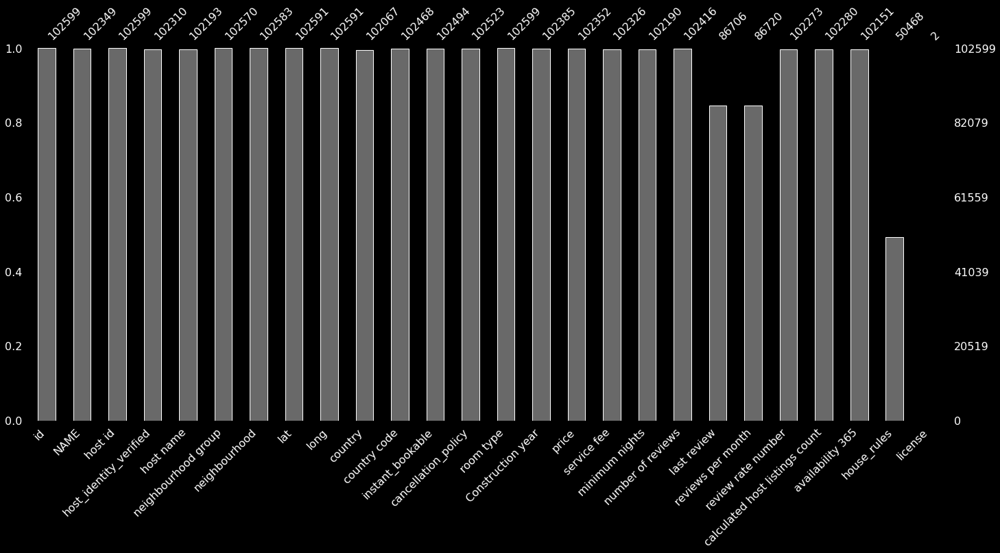

In [7]:
msno.bar(df)

<div style="background-color:#FF6B6C;color:#FFFFFB;padding:10px;border:2px solid #2E294E;font-size:1.2em;border-radius:10px">
    <h2 style="text-align:center">2.data cleaning</h2>
</div>

In [8]:
#Droping useless labels :
df.drop(["id","NAME","host id","host name","license"],axis=1,inplace=True)

In [9]:
#Checking data again 
df.head()

,host_identity_verified,neighbourhood group,neighbourhood,lat,long,country,country code,instant_bookable,cancellation_policy,room type,Construction year,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules
0,unconfirmed,Brooklyn,Kensington,40.64749,-73.97237,United States,US,False,strict,Private room,2020.0,$966,$193,10.0,9.0,10/19/2021,0.21,4.0,6.0,286.0,Clean up and treat the home the way you'd like...
1,verified,Manhattan,Midtown,40.75362,-73.98377,United States,US,False,moderate,Entire home/apt,2007.0,$142,$28,30.0,45.0,5/21/2022,0.38,4.0,2.0,228.0,Pet friendly but please confirm with me if the...
2,NaN,Manhattan,Harlem,40.80902,-73.94190,United States,US,True,flexible,Private room,2005.0,$620,$124,3.0,0.0,NaN,NaN,5.0,1.0,352.0,"I encourage you to use my kitchen, cooking and..."
3,unconfirmed,Brooklyn,Clinton Hill,40.68514,-73.95976,United States,US,True,moderate,Entire home/apt,2005.0,$368,$74,30.0,270.0,7/5/2019,4.64,4.0,1.0,322.0,NaN
4,verified,Manhattan,East Harlem,40.79851,-73.94399,United States,US,False,moderate,Entire home/apt,2009.0,$204,$41,10.0,9.0,11/19/2018,0.10,3.0,1.0,289.0,"Please no smoking in the house, porch or on th..."


In [10]:
#As we can see we have many NaN in last review and reviews per month
print("Number of nulls in last review : ",sum(df["last review"].isnull()))
print("Number of nulls in reviews per month : ",sum(df["reviews per month"].isnull()))

Number of nulls in last review :  15893
Number of nulls in reviews per month :  15879


In [11]:
df["last review"]

0         10/19/2021
1          5/21/2022
2                NaN
3           7/5/2019
4         11/19/2018
             ...    
102594           NaN
102595      7/6/2015
102596           NaN
102597    10/11/2015
102598           NaN
Name: last review, Length: 102599, dtype: object

In [12]:
df["reviews per month"]

0         0.21
1         0.38
2          NaN
3         4.64
4         0.10
          ... 
102594     NaN
102595    0.02
102596     NaN
102597    0.10
102598     NaN
Name: reviews per month, Length: 102599, dtype: float64

In [13]:
df["reviews per month"].mean()

1.374021909594096

In [14]:
#Filling NaN of reviews per month by the mean : 
df["reviews per month"].fillna(df["reviews per month"].mean(),inplace=True)

In [15]:
#Now lets go back to last review : 
df["last review"]

0         10/19/2021
1          5/21/2022
2                NaN
3           7/5/2019
4         11/19/2018
             ...    
102594           NaN
102595      7/6/2015
102596           NaN
102597    10/11/2015
102598           NaN
Name: last review, Length: 102599, dtype: object

In [16]:
#I will extract the year from last review :
def get_year(date):
  try:
    return str(date).split("/")[2]
  except:
    pass
df["lr_year"] = df["last review"].apply(get_year)

In [17]:
df["lr_year"].median()

2019.0

In [18]:
#As we can see the missing values of last review are the same as reviews per month that we filled with the mean
#I am droping the missing lr_year 
df[["reviews per month","lr_year"]]

,reviews per month,lr_year
0,0.210000,2021
1,0.380000,2022
2,1.374022,None
3,4.640000,2019
4,0.100000,2018
...,...,...
102594,1.374022,None
102595,0.020000,2015
102596,1.374022,None
102597,0.100000,2015


In [19]:
#I will drop last review because we dont need it 
df.drop(["last review"],axis=1,inplace=True)

<AxesSubplot:>

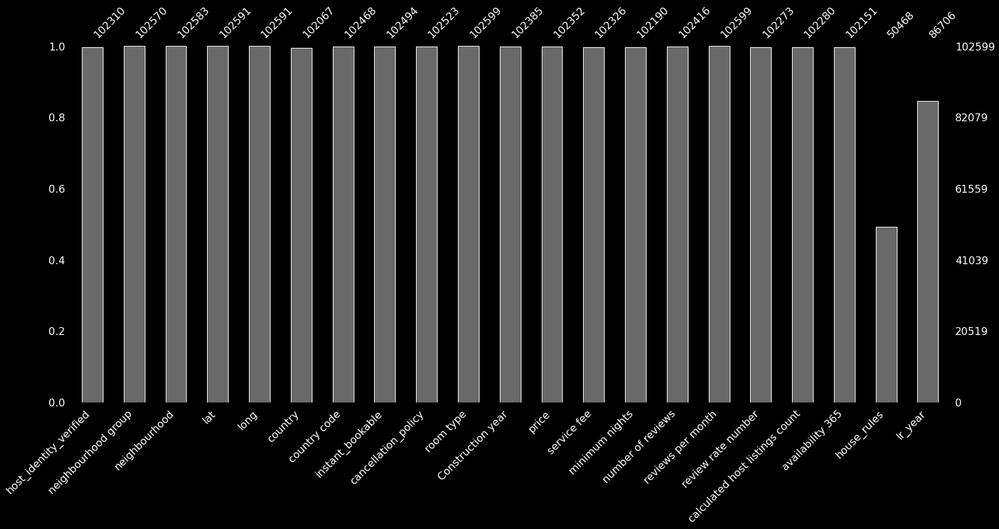

In [20]:
#Checking missing values again : 
msno.bar(df)

In [21]:
#checking the house rules : 
df["house_rules"].head()

0    Clean up and treat the home the way you'd like...
1    Pet friendly but please confirm with me if the...
2    I encourage you to use my kitchen, cooking and...
3                                                  NaN
4    Please no smoking in the house, porch or on th...
Name: house_rules, dtype: object

In [22]:
#I am droping the house rules
df.drop("house_rules",inplace=True,axis=1)

In [23]:
#I am droping all other missing values
df.dropna(inplace=True)

In [24]:
#As we can see all the data are from the same country so i am dropping it
df["country"].value_counts()

United States    84369
Name: country, dtype: int64

In [25]:
df.drop("country",inplace=True,axis=1)

In [26]:
#Change price to int number :
def price_convert(p):
    p = p[1::]
    s = p.split(",")
    return int("".join(s))
df["price"] = df["price"].apply(price_convert)

In [27]:
def price_convert(p):
    p = p[1::]
    s = p.split(",")
    return int("".join(s))
df["service fee"] = df["service fee"].apply(price_convert)

<AxesSubplot:>

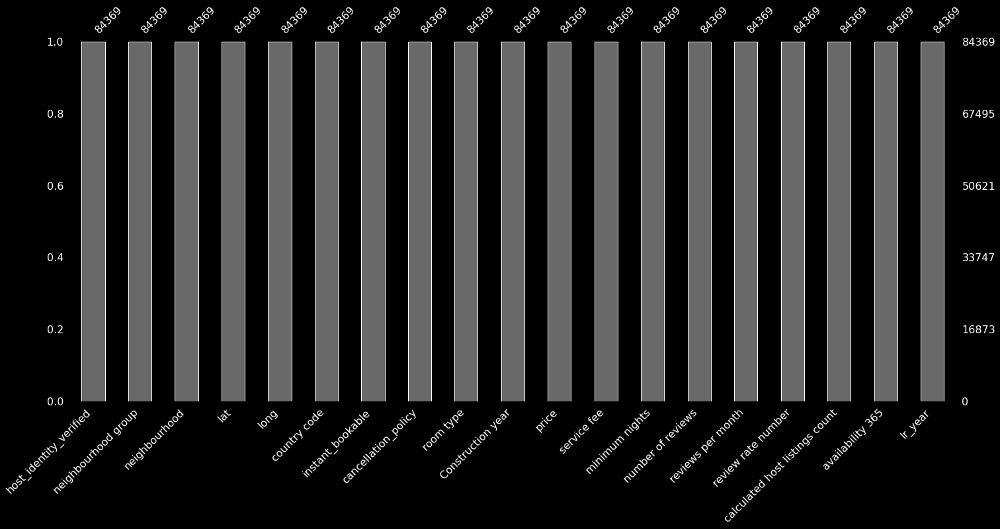

In [28]:
msno.bar(df)

<div style="background-color:#FF6B6C;color:#FFFFFB;padding:10px;border:2px solid #2E294E;font-size:1.2em;border-radius:10px">
    <h2 style="text-align:center">3.visualization</h2>
</div>

In [29]:
df["neighbourhood group"].value_counts()

Brooklyn         35031
Manhattan        34965
Queens           11248
Bronx             2296
Staten Island      828
brookln              1
Name: neighbourhood group, dtype: int64

In [30]:
#Plot char on the neighbourhood group :
ng = df["neighbourhood group"].value_counts() 
fig = px.bar(y = ng.values,
             x = ng.index,
             color = ng.index,
             color_discrete_sequence=px.colors.sequential.PuBuGn,
             text = ng.values,
             title = "Top Neighbourhood group",
             template = "plotly_dark"
             )
fig.update_layout(
    xaxis_title = "Neighbourhood group",
    yaxis_title = "count",
    font = dict(size=17,family="Franklin Gothic")
    )
fig.show()

In [31]:
#Comparing the price and place : 
fig = px.scatter_mapbox(df,
           lat="lat",
           lon="long",
           opacity = 0.3,
           hover_name="neighbourhood group",
           hover_data=["neighbourhood group", "price"],
           color="price",
           color_discrete_sequence=px.colors.sequential.PuBuGn,
           title = "Price comparing to the place",
           template = "plotly_dark",
           zoom=10
           )
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},font = dict(size=17,family="Franklin Gothic"))
fig.show()

In [32]:
#Pie chart on host identity (verified,unconfirmed) : 
host_ident = df["host_identity_verified"].value_counts()
fig = px.pie(
    values = host_ident.values,
    names = host_ident.index,
    color_discrete_sequence=px.colors.sequential.PuBu,
    title= 'Host identity distribution',template='plotly_dark'
)
fig.update_layout(
    font=dict(size=17,family="Franklin Gothic"))
fig.show()

In [33]:
#Comparing the host identity to the price
fig = px.box(
    x=df["host_identity_verified"],
    y=df['price'],
    template= 'plotly_dark', 
    title = 'Host identity confirmation comparing to the price')
fig.update_layout(
    xaxis_title = "Host identity",
    yaxis_title = "price",
    font = dict(size=17, family="Franklin Gothic")) 
fig.show()

In [34]:
#Room types
rm = df["room type"].value_counts() 
fig = px.bar(y = rm.values,
             x = rm.index,
             color = rm.index,
             color_discrete_sequence=px.colors.sequential.PuBuGn,
             text = rm.values,
             title = "Room type",
             template = "plotly_dark"
             )
fig.update_layout(
    xaxis_title = "Room type",
    yaxis_title = "count",
    font = dict(size=17,family="Franklin Gothic")
    )
fig.show()

In [35]:
#Room types compared to the price
fig = px.box(
    x=df["room type"],
    y=df['price'],
    template= 'plotly_dark', 
    title = 'Room type compared to the price')
fig.update_layout(
    xaxis_title = "Room type",
    yaxis_title = "price",
    font = dict(size=17, family="Franklin Gothic")) 
fig.show()

In [36]:
#a map on room types
fig = px.scatter_mapbox(df,
           lat="lat",
           lon="long",
           opacity = 0.3,
           hover_name="neighbourhood group",
           hover_data=["neighbourhood group", "room type"],
           color="room type",
            color_discrete_sequence=px.colors.qualitative.Dark24,
           title = "Price comparing to the place",
           template = "plotly_dark",
           zoom=10
           )
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},font = dict(size=17,family="Franklin Gothic"))
fig.show()

In [37]:
#Comparing the host identity to the price
fig = px.box(
    x=df["cancellation_policy"],
    y=df['price'],
    template= 'plotly_dark', 
    title = 'cancellation policy compared to the price')
fig.update_layout(
    xaxis_title = "concellation policy",
    yaxis_title = "price",
    font = dict(size=17, family="Franklin Gothic")) 
fig.show()

In [38]:
df["minimum nights"].value_counts()[:10]

2.0     20898
1.0     20680
3.0     13926
30.0     9171
4.0      5578
5.0      4936
7.0      2951
6.0      1261
14.0      788
10.0      703
Name: minimum nights, dtype: int64

In [39]:
df.head()

,host_identity_verified,neighbourhood group,neighbourhood,lat,long,country code,instant_bookable,cancellation_policy,room type,Construction year,price,service fee,minimum nights,number of reviews,reviews per month,review rate number,calculated host listings count,availability 365,lr_year
0,unconfirmed,Brooklyn,Kensington,40.64749,-73.97237,US,False,strict,Private room,2020.0,966,193,10.0,9.0,0.21,4.0,6.0,286.0,2021
1,verified,Manhattan,Midtown,40.75362,-73.98377,US,False,moderate,Entire home/apt,2007.0,142,28,30.0,45.0,0.38,4.0,2.0,228.0,2022
3,unconfirmed,Brooklyn,Clinton Hill,40.68514,-73.95976,US,True,moderate,Entire home/apt,2005.0,368,74,30.0,270.0,4.64,4.0,1.0,322.0,2019
4,verified,Manhattan,East Harlem,40.79851,-73.94399,US,False,moderate,Entire home/apt,2009.0,204,41,10.0,9.0,0.10,3.0,1.0,289.0,2018
5,verified,Manhattan,Murray Hill,40.74767,-73.97500,US,True,flexible,Entire home/apt,2013.0,577,115,3.0,74.0,0.59,3.0,1.0,374.0,2019


In [40]:
#I will categorize the price
df["price"].median()

625.0

In [41]:
def cato_price(p):
  if(p > 600):
    return("More than 600")
  else:
    return("less than 600")
df["cat_price"] = df["price"].apply(cato_price)

In [42]:
labels = ["host_identity_verified","neighbourhood group","room type","cat_price"]
fig = px.parallel_categories(
    df[labels],
    template= 'plotly_dark',
    labels = {"instant_bookable":"instant bookable","host_identity_verified":"host identity","cat_price":"price"}
    )
fig.show()

In [43]:
#3D plot on the host listings counts , number of reviews and review rate number
fig = px.scatter_3d(df, 
                    z='calculated host listings count', 
                    y='number of reviews', 
                    x='review rate number',
                    color='cat_price',
                    template="plotly_dark",
                    color_discrete_sequence=px.colors.qualitative.G10,
                    labels={"cat_price":"price"}
                    )
fig.show()

<div style="background-color:#FF6B6C;color:#FFFFFB;padding:10px;border:2px solid #2E294E;font-size:1.2em;border-radius:10px">
    <h2 style="text-align:center">Thanks for watching !</h2>
</div>